In [1]:
import csv
import os
import numpy as np
import matplotlib.pyplot as plt
import fit_analysis as fa

In [2]:
path = '/home/kernfel/Documents/Data/RTDO/B1_Thomas/sessions/2019.11.27-17.31.26/'

files = [f for f in os.listdir(path) if f.endswith('.cost')]

In [5]:
files

['0001.GAFitter.closedloop.cost',
 '0002.GAFitter.closedloop.cost',
 '0003.GAFitter.closedloop.cost',
 '0004.GAFitter.closedloop.cost',
 '0005.GAFitter.closedloop.cost',
 '0007.GAFitter.closedloop.cost',
 '0008.GAFitter.closedloop.cost',
 '0009.GAFitter.closedloop.cost',
 '0010.GAFitter.closedloop.cost',
 '0011.GAFitter.closedloop.cost',
 '0013.GAFitter.closedloop.cost',
 '0014.GAFitter.closedloop.cost',
 '0015.GAFitter.closedloop.cost',
 '0016.GAFitter.closedloop.cost',
 '0017.GAFitter.closedloop.cost',
 '0019.GAFitter.closedloop.cost',
 '0020.GAFitter.closedloop.cost',
 '0021.GAFitter.closedloop.cost',
 '0022.GAFitter.closedloop.cost',
 '0023.GAFitter.closedloop.cost',
 '0025.GAFitter.closedloop.cost',
 '0026.GAFitter.closedloop.cost',
 '0027.GAFitter.closedloop.cost',
 '0028.GAFitter.closedloop.cost',
 '0029.GAFitter.closedloop.cost',
 '0031.GAFitter.closedloop.cost',
 '0032.GAFitter.closedloop.cost',
 '0033.GAFitter.closedloop.cost',
 '0034.GAFitter.closedloop.cost',
 '0035.GAFitte

/usr/lib64/python2.7/site-packages/matplotlib/pyplot.py:537: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  max_open_warning, RuntimeWarning)


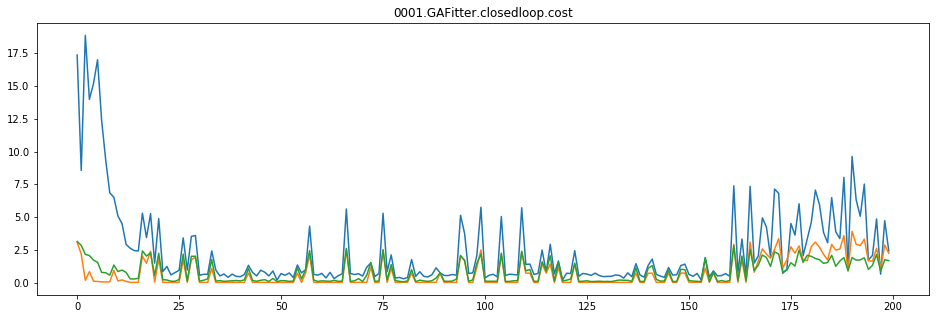

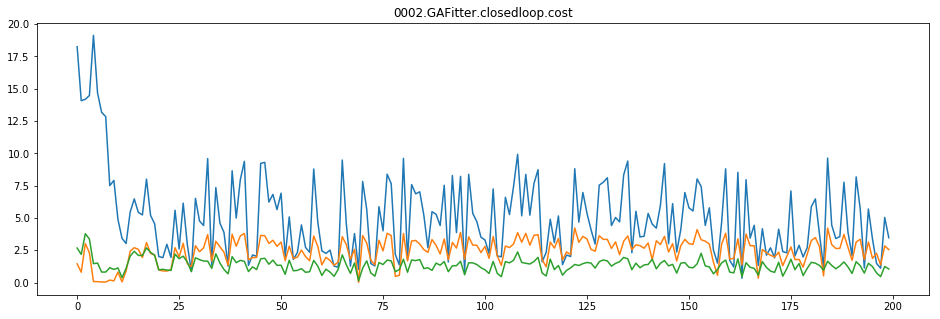

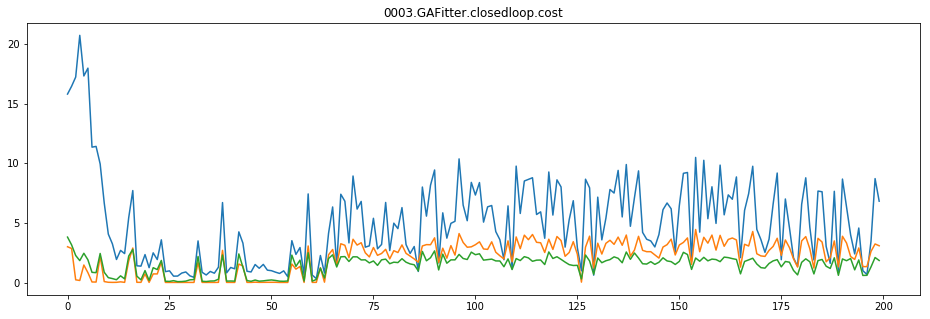

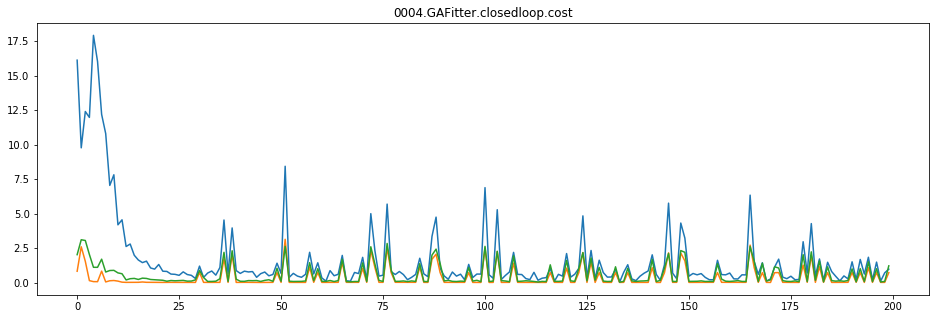

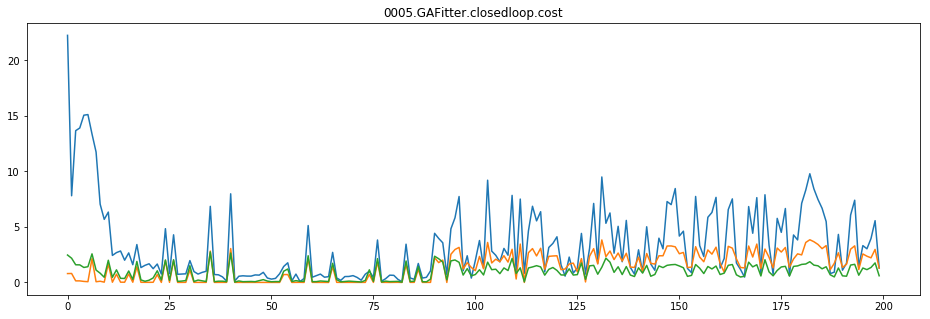

...

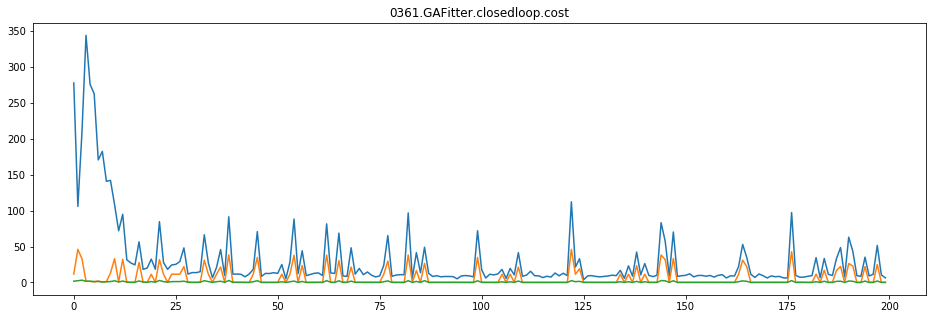

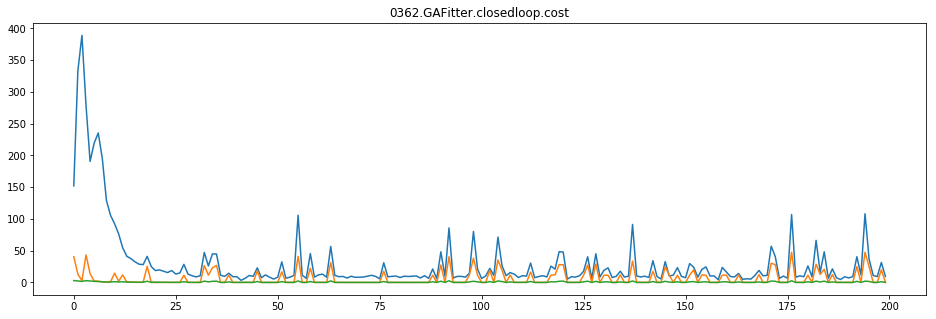

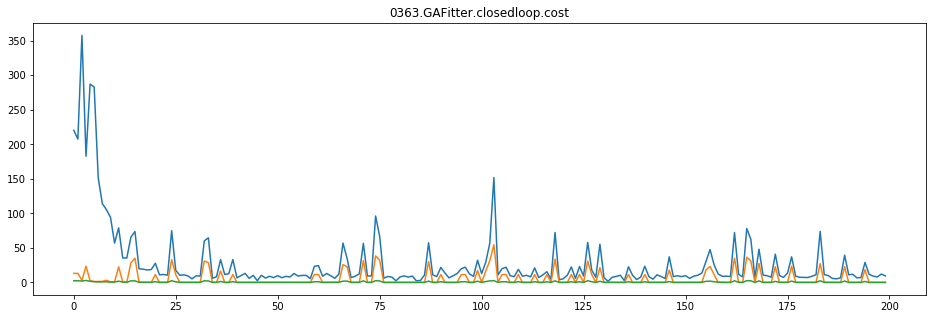

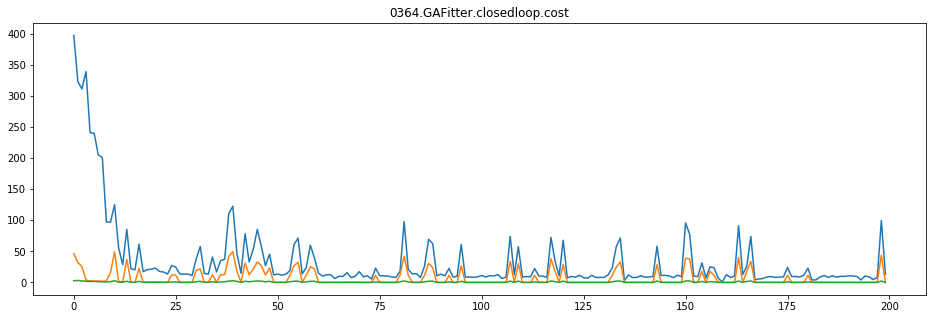

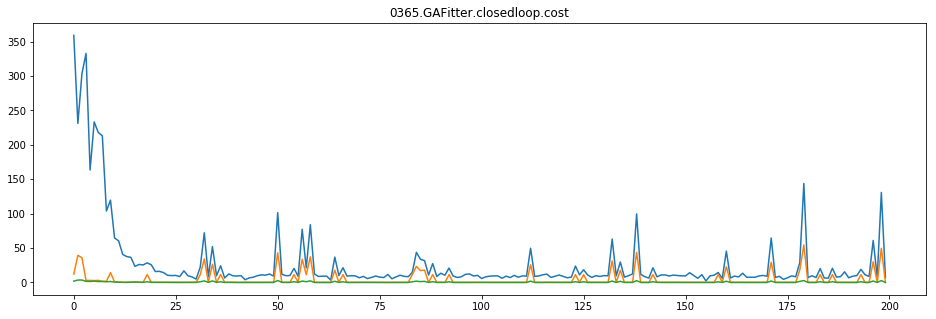

In [6]:
for f in files:
    with open(path + f) as tsv:
        data = np.array([[float(row[0]),float(row[1]),float(row[2])] for row in csv.reader(tsv, delimiter = '\t')]).T
        plt.figure(figsize=(16,5))
        plt.plot(data[0])
        plt.plot(data[1])
        plt.plot(data[2])
        plt.title(f)

In [3]:
S = fa.Session(path, 'full.index', 'B1', load=False, ftype='closedloop')

In [4]:
S.load_populations()

Loading row 0 of 305, fileno 0001...
Loading row 1 of 305, fileno 0002...
Loading row 2 of 305, fileno 0003...
Loading row 3 of 305, fileno 0004...
Loading row 4 of 305, fileno 0005...
Loading row 5 of 305, fileno 0007...
Loading row 6 of 305, fileno 0008...
Loading row 7 of 305, fileno 0009...
Loading row 8 of 305, fileno 0010...
Loading row 9 of 305, fileno 0011...
Loading row 10 of 305, fileno 0013...
Loading row 11 of 305, fileno 0014...
Loading row 12 of 305, fileno 0015...
Loading row 13 of 305, fileno 0016...
Loading row 14 of 305, fileno 0017...
Loading row 15 of 305, fileno 0019...
Loading row 16 of 305, fileno 0020...
Loading row 17 of 305, fileno 0021...
Loading row 18 of 305, fileno 0022...
Loading row 19 of 305, fileno 0023...
Loading row 20 of 305, fileno 0025...
Loading row 21 of 305, fileno 0026...
Loading row 22 of 305, fileno 0027...
Loading row 23 of 305, fileno 0028...
Loading row 24 of 305, fileno 0029...
Loading row 25 of 305, fileno 0031...
Loading row 26 of 305,

Loading row 213 of 305, fileno 0256...
Loading row 214 of 305, fileno 0257...
Loading row 215 of 305, fileno 0259...
Loading row 216 of 305, fileno 0260...
Loading row 217 of 305, fileno 0261...
Loading row 218 of 305, fileno 0262...
Loading row 219 of 305, fileno 0263...
Loading row 220 of 305, fileno 0265...
Loading row 221 of 305, fileno 0266...
Loading row 222 of 305, fileno 0267...
Loading row 223 of 305, fileno 0268...
Loading row 224 of 305, fileno 0269...
Loading row 225 of 305, fileno 0271...
Loading row 226 of 305, fileno 0272...
Loading row 227 of 305, fileno 0273...
Loading row 228 of 305, fileno 0274...
Loading row 229 of 305, fileno 0275...
Loading row 230 of 305, fileno 0277...
Loading row 231 of 305, fileno 0278...
Loading row 232 of 305, fileno 0279...
Loading row 233 of 305, fileno 0280...
Loading row 234 of 305, fileno 0281...
Loading row 235 of 305, fileno 0283...
Loading row 236 of 305, fileno 0284...
Loading row 237 of 305, fileno 0285...
Loading row 238 of 305, f

In [5]:
g_final = dict([(n,0) for n in S.gnames])
for row in S.index:
    g_final[row['group']] += np.linalg.norm(row['median'][-1,:,0] - row['reference'])

In [6]:
g = np.zeros((5,5,5))
minimum = 500.
for n, x in g_final.iteritems():
    g[tuple([int(s[-1]) for s in n.split(' ')])] = x
    minimum = min(x,minimum)

In [7]:
minimum, np.max(g)

(230.24271803139973, 313.8991377399551)

In [65]:
def heatmaps(data, **kwargs):
    plt.figure(figsize=(12,5))
    plt.subplot(1,3,1)
    plt.imshow(data[0,:,:], cmap='hot', interpolation='nearest', **kwargs)
    plt.gca().set_ylabel('spikes')
    plt.gca().set_xlabel('delay')
    plt.gca().invert_yaxis()

    plt.subplot(1,3,2)
    plt.imshow(data[:,0,:], cmap='hot', interpolation='nearest', **kwargs)
    plt.gca().set_ylabel('trace')
    plt.gca().set_xlabel('delay')
    plt.gca().invert_yaxis()

    plt.subplot(1,3,3)
    plt.imshow(data[:,:,0], cmap='hot', interpolation='nearest', **kwargs)
    plt.gca().set_ylabel('trace')
    plt.gca().set_xlabel('spikes')
    plt.gca().invert_yaxis()

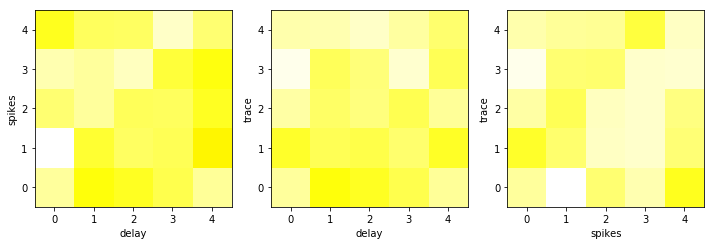

In [66]:
heatmaps(g, vmin=0, vmax=np.max(g))

In [22]:
print S.index[0]['group']
for row in S.index:
    row['cost_weight'], row['cost_weight_exp'] = [0,0,0], [0,0,0]
    for i, wstr in enumerate(row['group'].split(' ')):
        x = int(wstr[-1])
        row['cost_weight_exp'][i] = x
        row['cost_weight'][i] = 2 ** x

trace0 spike0 delay0


In [36]:
for row in S.index:
    costfile = S.path + '/%04d.GAFitter.%s.cost' % (row['fileno'], S.ftype)
    row['cost'] = [0,0,0]
    with open(costfile) as tsv:
        data = np.array([[float(r[0]),float(r[1]),float(r[2])] for r in csv.reader(tsv, delimiter = '\t')])
        row['cost'] = (data / row['cost_weight']).T

In [53]:
final_epochs = 20

cost = np.zeros((3,5,5,5))
for row in S.index:
    for i in range(3):
        cost[i][tuple(row['cost_weight_exp'])] += np.mean(row['cost'][i, -final_epochs:])

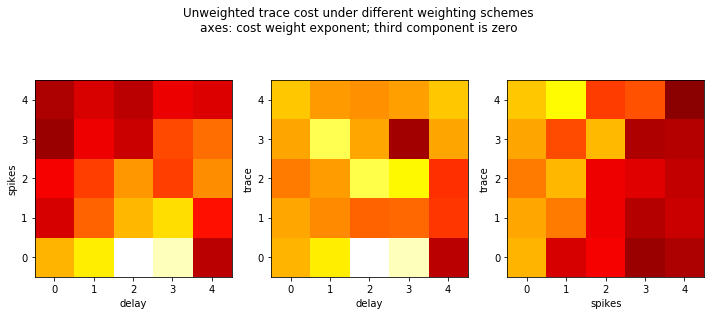

In [80]:
heatmaps(cost[0], vmin = 0, vmax=np.max(cost[0]))
plt.suptitle('Unweighted trace cost under different weighting schemes\naxes: cost weight exponent; third component is zero');

Succinctly put, for trace cost, cranking spike weight above both trace and delay is good. Best results at high spike over mid-to-low trace and delay.

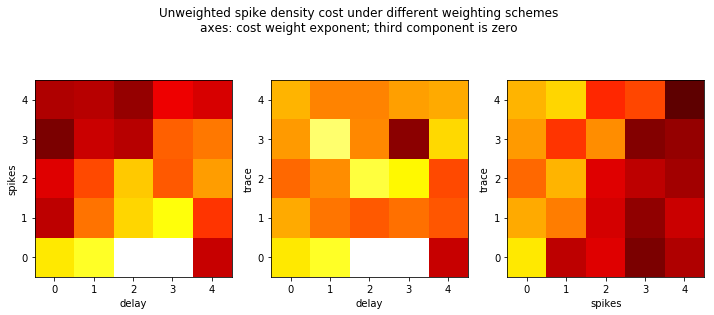

In [79]:
heatmaps(cost[1], vmin = 0, vmax=np.max(cost[1]))
plt.suptitle('Unweighted spike density cost under different weighting schemes\naxes: cost weight exponent; third component is zero');

For spike cost, too, crank spike weight above mid-to-low trace and delay.

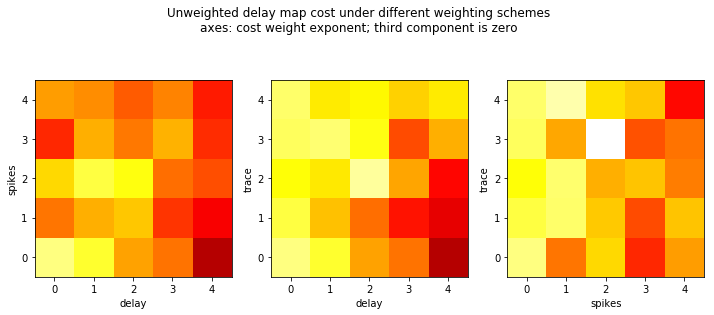

In [78]:
heatmaps(cost[2], vmin = 0, vmax=np.max(cost[2]))
plt.suptitle('Unweighted delay map cost under different weighting schemes\naxes: cost weight exponent; third component is zero');

For delay cost, the relationships are a little less clear. High delay cost with mid-to-low trace has some positive effect.

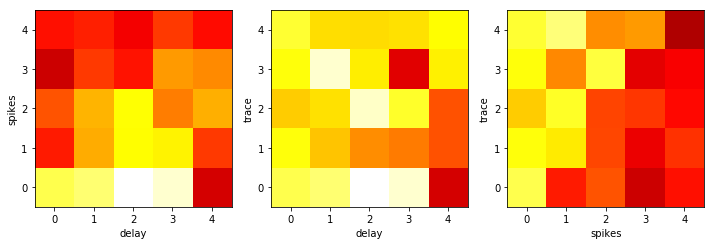

In [77]:
cost_norm = np.mean(cost / np.mean(cost, axis=(1,2,3))[:,None,None,None], axis=0)
heatmaps(cost_norm, vmin=0, vmax=np.max(cost_norm))

Overall best combination looks to be high spike weight, lower trace and delay weight. There is some interaction between trace and delay weight, with delay over trace getting better results than vice versa.
